# 5 SCIPLEX OOD SPLITS

**Requires**
* `'trapnell_cpa_lincs_genes.h5ad'`
* `'trapnell_cpa.h5ad'`

**Output**
* `'sciplex_complete.h5ad'`
* `'sciplex_complete_lincs_genes.h5ad'`


## Description

The main purpose of this notebook is to create various subdatasets and splits of the data created in previous notebooks.&#x20;

### Datasets

The complete set of datasets created throughout this notebook is listed in the following table:

| **Dataset Name**                                         | **Purpose**                                      | **Includes Splits?**                                                | **Notes**                                                                          |
| -------------------------------------------------------- | ------------------------------------------------ | ------------------------------------------------------------------- | ---------------------------------------------------------------------------------- |
| **`sciplex_complete.h5ad`**                              | Complete dataset                                 | No                                                                  | Full dataset without any modifications.                                            |
| **`sciplex_complete_lincs_genes.h5ad`**                  | Complete dataset focusing on LINCS genes         | No                                                                  | Similar to above but specific to LINCS genes.                                      |
| **`adata_MCF7.h5ad`**                                    | Cell-type specific (MCF7) dataset                | No                                                                  | Subset of `sciplex_complete.h5ad` for MCF7 cells.                                  |
| **`adata_MCF7_lincs_genes.h5ad`**                        | LINCS-specific MCF7 dataset                      | No                                                                  | Subset of `sciplex_complete_lincs_genes.h5ad` for MCF7 cells.                      |
| **`adata_K562.h5ad`**                                    | Cell-type specific (K562) dataset                | No                                                                  | Subset of `sciplex_complete.h5ad` for K562 cells.                                  |
| **`adata_K562_lincs_genes.h5ad`**                        | LINCS-specific K562 dataset                      | No                                                                  | Subset of `sciplex_complete_lincs_genes.h5ad` for K562 cells.                      |
| **`adata_A549.h5ad`**                                    | Cell-type specific (A549) dataset                | No                                                                  | Subset of `sciplex_complete.h5ad` for A549 cells.                                  |
| **`adata_A549_lincs_genes.h5ad`**                        | LINCS-specific A549 dataset                      | No                                                                  | Subset of `sciplex_complete_lincs_genes.h5ad` for A549 cells.                      |
| **`sciplex_complete_subset_lincs_genes_v2.h5ad`**        | Small dataset with 40 observations per condition | Partially (`split`)                                                 | Randomly subsampled, basic splits (`train`, `test`, `ood`) added.                  |
| **`sciplex_complete_middle_subset_v2.h5ad`**             | Middle-sized dataset with dosage diversity       | Partially (`split_ood_finetuning`)                                  | Observations subsampled by dosage, basic splits (`ood`, `train`, `test`) included. |
| **`sciplex_complete_middle_subset_lincs_genes_v2.h5ad`** | Middle-sized LINCS-specific dataset              | Partially (`split_ood_finetuning`)                                  | Same as above but focused on LINCS genes.                                          |
| **`sciplex_complete_v2.h5ad`**                           | Final processed dataset                          | Yes (`split_ood_finetuning`, `split_ho_epigenetic`, `split_random`) | Fully annotated with all splits.                                                   |
| **`sciplex_complete_lincs_genes_v2.h5ad`**               | Final LINCS-specific processed dataset           | Yes (`split_ood_finetuning`, `split_ho_epigenetic`, `split_random`) | Fully annotated with all splits and LINCS gene focus.                              |



### Splits

For convenience, we also describe how the splits are created, but you may also look into the code below

### `split_ood_finetuning` (Main Train/Test/OOD Split)

This split simply divides the entire dataset into **train**, **test**, and **OOD** categories, as follows:

- **Train**: All rows are initially assigned to `'train'`.

- **OOD**: Rows where the drug (`condition`) is one of the predefined **OOD drugs** (`Dacinostat`, `CUDC-907`, `Givinostat`, `CUDC-101`, `Pirarubicin`, `Hesperadin`, `Tanespimycin`, `Trametinib`, `Raltitrexed`) are reassigned to `'ood'`.

- **Test**: Rows are assigned to `'test'` in three steps:

  1. **Validation Drugs**: 40% of rows for specific validation drugs at high doses (`1e3` or `1e4`) and 20% for lower doses (`1e1` or `1e2`).
  2. **Random Sample**: 4% of remaining `'train'` rows are moved to `'test'`.
  3. **Control Rows**: 5% of control rows (`control == 1`) are moved to `'test'`.

### 2. `split_ho_epigenetic` (Epigenetic Holdout Split)

The validation and OOD splits in this dataset focus on epigenetic regulation. They are sampled by using a predefined selection of epigenetic drugs:

- **Validation Epigenetic Drugs**

  - Trichostatin, CUDC-101, M344, Resminostat, Entinostat, Tucidinostat, Tacedinaline, Mocetinostat, Pracinostat.

- **Out-of-Distribution Epigenetic Drugs**

  - Dacinostat, Quisinostat, CUDC-907, Abexinostat, Panobinostat, Belinostat, Givinostat, AR-42.

These splits are then defined as follows:

- **Train**: All rows initially assigned to `'train'`
- **Test**: Rows are moved to `'test'` in several steps:
  1. **Validation Drugs for High Doses**: 40% of the samples with validation epigenetic drugs at high doses (`1e3` or `1e4`) are moved to `'test'`.
  2. **Validation Drugs for Low Doses**: 40% of the samples with validation epigenetic drugs at lower doses (`1e1` or `1e2`) are also moved to `'test'`.
  3. **Remaining Epigenetic Drugs**: 40% of samples for epigenetic drugs that are not part of the primary training set (`epigenetic_drugs_all` excluding `epigenetic_drugs`) are moved to `'test'`.
  4. **Control Samples**: 40% of the control samples (`control == 1`) are moved to `'test'` to ensure proper evaluation of untreated conditions.
- **OOD**: Observations treated with any drug inside `ood_epi_drugs` are reassigned to `'ood'`.

### 3. `split_ho_epigenetic_all` (All Epigenetic Holdout Split)

Similar to `split_ho_epigenetic`, but this split users the **remaining epigenetic drugs that are not manually selected** in section 2. Specifically:

The set of drugs used in this split (`epigenetic_drugs_all`) is defined as all unique drugs within the dataset that are associated with the pathway **'Epigenetic regulation'**. This is determined by selecting all drugs for which the pathway information (`pathway_level_1`) is labeled as **'Epigenetic regulation'**.

- **Train**: Initially, all rows are assigned to `'train'`.

- **Test**: Rows are reassigned to `'test'` in several steps:

  1. **Initial Split**: 5% of the entire dataset is randomly selected and reassigned to `'test'`.
  2. **Epigenetic Drug Validation**: 50% of samples treated with epigenetic drugs that are not in the main training set (`epigenetic_drugs_all` excluding `epigenetic_drugs`) are reassigned to `'test'`.
  3. **Control Samples**: 40% of control samples (`control == 1`) are reassigned to `'test'` to ensure proper evaluation of untreated conditions.

- **OOD**: Observations treated with any drug within `epigenetic_drugs` are reassigned to `'ood'`.

### 4. `split_random` (Random Split)

The entire dataset is divided as follows:

- **Train**: 70% of the rows are randomly assigned to `'train'`.
- **Test**: 15% of the rows are randomly assigned to `'test'`.
- **OOD**: 15% of the rows are randomly assigned to `'ood'`. This split serves as a straightforward baseline, ensuring a random distribution of conditions across the splits without specific considerations for pathways or drug types.



## Imports

In [4]:
import os
import logging

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import sfaira
from rdkit import Chem, DataStructs
from rdkit.Chem import Draw
from rdkit.Chem.Draw import IPythonConsole

from chemCPA.paths import DATA_DIR, PROJECT_DIR

IPythonConsole.ipython_useSVG = False
matplotlib.style.use("fivethirtyeight")
# matplotlib.style.use("seaborn-talk")
matplotlib.rcParams['font.family'] = "monospace"
matplotlib.rcParams['figure.dpi'] = 200
matplotlib.pyplot.rcParams['savefig.facecolor'] = 'white'
os.getcwd()
pd.set_option('display.max_columns', 100)
sc.set_figure_params(dpi=80, frameon=False)
sc.logging.print_header()
sns.set_context("poster")
import rapids_singlecell as rsc

logging.basicConfig(level=logging.INFO)


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.6 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.2 pynndescent==0.5.6


In [5]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load data

In [6]:
logging.info("Starting to load in data from %s", PROJECT_DIR/'datasets'/'trapnell_cpa_lincs_genes.h5ad')
adata_sciplex_lincs_genes = sc.read(PROJECT_DIR/'datasets'/'trapnell_cpa_lincs_genes.h5ad')
logging.info("Data loaded from %s", PROJECT_DIR/'datasets'/'trapnell_cpa_lincs_genes.h5ad')
logging.info("Starting to load in data from %s", PROJECT_DIR/'datasets'/'trapnell_cpa.h5ad')
adata_sciplex = sc.read(PROJECT_DIR/'datasets'/'trapnell_cpa.h5ad')
logging.info("Data loaded from %s", PROJECT_DIR/'datasets'/'trapnell_cpa.h5ad')

In [13]:
if 'log1p' in adata_sciplex.uns:
    del adata_sciplex.uns['log1p']

if 'log1p' in adata_sciplex_lincs_genes.uns:
    del adata_sciplex_lincs_genes.uns['log1p']

# Compute highly variable genes

In [14]:
import cupy as cp

# Convert to dense numpy array and then to cupy array
logging.info("Starting computation of highly variable genes for adata_sciplex_lincs_genes")
adata_sciplex_lincs_genes.X = cp.array(adata_sciplex_lincs_genes.X.toarray())
rsc.pp.highly_variable_genes(adata_sciplex_lincs_genes, n_top_genes=977)
logging.info("Finished computation of highly variable genes for adata_sciplex_lincs_genes")

In [15]:
logging.info("Starting computation of highly variable genes for adata_sciplex")
adata_sciplex.X = cp.array(adata_sciplex.X.toarray())
rsc.pp.highly_variable_genes(adata_sciplex, n_top_genes=2000)
logging.info("Finished computation of highly variable genes for adata_sciplex")

## Compute UMAP

In [16]:
! mamba list | grep pynndescent
! mamba list | grep umap

pynndescent               0.5.6              pyh6c4a22f_0    conda-forge
umap-learn                0.5.3            py37h89c1867_0    conda-forge


In [17]:
def preprocess_adata(adata, n_comps=25, n_neighbors=50):
    rsc.pp.pca(adata, n_comps=n_comps)
    rsc.pp.neighbors(adata, n_neighbors=n_neighbors, metric='cosine')
    rsc.tl.umap(adata, min_dist=0.1)
    return None

def preprocess_adata_subset_type(adata, cell_type, n_comps=25):
    adata_new = adata[adata.obs.cell_type == cell_type].copy()
    rsc.pp.pca(adata_new, n_comps=n_comps)
    rsc.pp.neighbors(adata_new, n_neighbors=50, metric='cosine')
    rsc.tl.umap(adata_new, min_dist=0.1)
    return adata_new

In [18]:
# This can take >20min to process
logging.info("Starting preprocessing of adata_sciplex")
preprocess_adata(adata_sciplex, n_comps=25, n_neighbors=50)
logging.info("Completed preprocessing of adata_sciplex")

In [19]:
# This can take >20min to process
logging.info("Starting preprocessing of adata_sciplex_lincs_genes")
preprocess_adata(adata_sciplex_lincs_genes)
logging.info("Completed preprocessing of adata_sciplex_lincs_genes")

## Load or create subsetted adata objects

In [20]:
# +
logging.info("Starting to load/create subsetted adata objects")

# MCF7
fname = PROJECT_DIR/'datasets'/'adata_MCF7.h5ad'
logging.info("Processing MCF7 data from %s", fname)
if not fname.exists():
    logging.info("File not found, creating new MCF7 dataset")
    adata_MCF7 = preprocess_adata_subset_type(adata_sciplex, "MCF7")
    sc.write(fname, adata_MCF7)
    logging.info("MCF7 dataset saved to %s", fname)
else: 
    logging.info("Loading existing MCF7 dataset")
    adata_MCF7 = sc.read(fname)
    
# MCF7 LINCS genes
fname = PROJECT_DIR/'datasets'/'adata_MCF7_lincs_genes.h5ad'    
logging.info("Processing MCF7 LINCS genes data from %s", fname)
if not fname.exists():
    logging.info("File not found, creating new MCF7 LINCS genes dataset")
    adata_MCF7_lincs_genes = preprocess_adata_subset_type(adata_sciplex_lincs_genes, "MCF7")
    sc.write(fname, adata_MCF7_lincs_genes)
    logging.info("MCF7 LINCS genes dataset saved to %s", fname)
else: 
    logging.info("Loading existing MCF7 LINCS genes dataset")
    adata_MCF7_lincs_genes = sc.read(fname)

# K562
fname = PROJECT_DIR/'datasets'/'adata_K562.h5ad'
logging.info("Processing K562 data from %s", fname)
if not fname.exists():
    logging.info("File not found, creating new K562 dataset")
    adata_K562 = preprocess_adata_subset_type(adata_sciplex, "K562")
    sc.write(fname, adata_K562)
    logging.info("K562 dataset saved to %s", fname)
else: 
    logging.info("Loading existing K562 dataset")
    adata_K562 = sc.read(fname)

# K562 LINCS genes
fname = PROJECT_DIR/'datasets'/'adata_K562_lincs_genes.h5ad'
logging.info("Processing K562 LINCS genes data from %s", fname)
if not fname.exists():
    logging.info("File not found, creating new K562 LINCS genes dataset")
    adata_K562_lincs_genes = preprocess_adata_subset_type(adata_sciplex_lincs_genes, "K562")
    sc.write(fname, adata_K562_lincs_genes)
    logging.info("K562 LINCS genes dataset saved to %s", fname)
else: 
    logging.info("Loading existing K562 LINCS genes dataset")
    adata_K562_lincs_genes = sc.read(fname)

# A549
fname = PROJECT_DIR/'datasets'/'adata_A549.h5ad'
logging.info("Processing A549 data from %s", fname)
if not fname.exists():    
    logging.info("File not found, creating new A549 dataset")
    adata_A549 = preprocess_adata_subset_type(adata_sciplex, "A549")
    sc.write(fname, adata_A549)
    logging.info("A549 dataset saved to %s", fname)
else: 
    logging.info("Loading existing A549 dataset")
    adata_A549 = sc.read(fname)

# A549 LINCS genes
fname = PROJECT_DIR/'datasets'/'adata_A549_lincs_genes.h5ad'
logging.info("Processing A549 LINCS genes data from %s", fname)
if not fname.exists():    
    logging.info("File not found, creating new A549 LINCS genes dataset")
    adata_A549_lincs_genes = preprocess_adata_subset_type(adata_sciplex_lincs_genes, "A549")
    sc.write(fname, adata_A549_lincs_genes)
    logging.info("A549 LINCS genes dataset saved to %s", fname)
else: 
    logging.info("Loading existing A549 LINCS genes dataset")
    adata_A549_lincs_genes = sc.read(fname)

logging.info("Completed loading/creating all subsetted adata objects")

## Plot pathways for different cell lines

In [21]:
pathways = [
#     'Antioxidant', 
    'Apoptotic regulation', 
    'Cell cycle regulation',
    'DNA damage & DNA repair', 
    'Epigenetic regulation',
#     'Focal adhesion signaling', 
    'HIF signaling', 
    'JAK/STAT signaling',
#     'Metabolic regulation', 
#     'Neuronal signaling',
    'Nuclear receptor signaling', 
#     'Other', 
    'PKC signaling',
    'Protein folding & Protein degradation', 
#     'TGF/BMP signaling',
    'Tyrosine kinase signaling', 
#     'Vehicle'
]


### LINCS genes

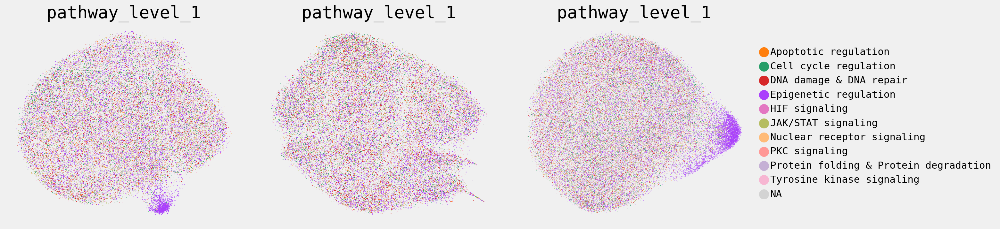

In [22]:
dose = 1e4

fig, ax = plt.subplots(1, 3, figsize=(20, 5))

sc.pl.umap(
    adata_A549_lincs_genes[adata_A549_lincs_genes.obs.dose==dose].copy(), 
    color='pathway_level_1', 
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[0]
)
sc.pl.umap(
    adata_K562_lincs_genes[adata_K562_lincs_genes.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[1]
)
sc.pl.umap(
    adata_MCF7_lincs_genes[adata_MCF7_lincs_genes.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[2]
)
ax[0].get_legend().remove()
ax[1].get_legend().remove()
plt.tight_layout()

### All genes

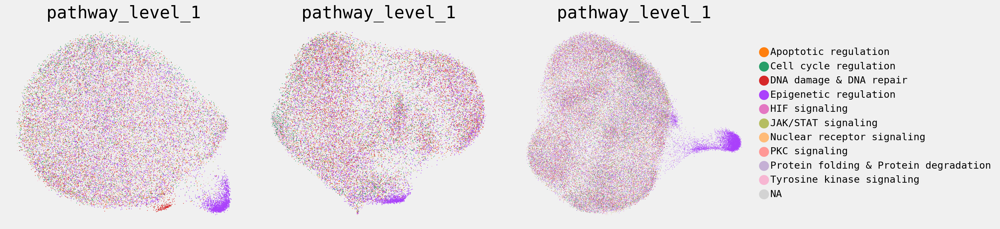

In [23]:
dose = 1e4

fig, ax = plt.subplots(1, 3, figsize=(20, 5))

sc.pl.umap(
    adata_A549[adata_A549.obs.dose==dose].copy(), 
    color='pathway_level_1', 
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[0]
)
sc.pl.umap(
    adata_K562[adata_K562.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[1]
)
sc.pl.umap(
    adata_MCF7[adata_MCF7.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[2]
)
ax[0].get_legend().remove()
ax[1].get_legend().remove()
plt.tight_layout()

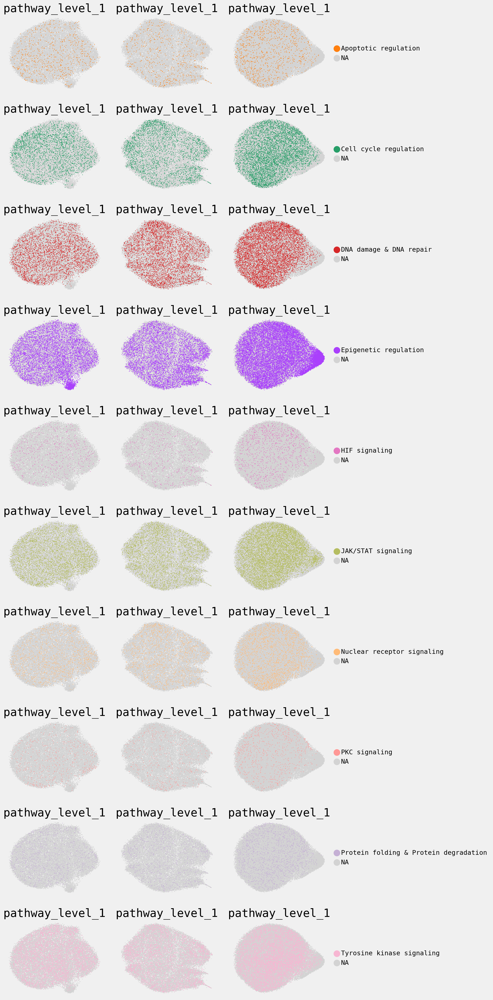

In [24]:
dose = 1e4
cond_A549 = adata_A549_lincs_genes.obs.dose==dose
cond_K562 = adata_K562_lincs_genes.obs.dose==dose
cond_MCF7 = adata_MCF7_lincs_genes.obs.dose==dose

cols = 3
rows = len(pathways)
size = 7
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, pw in enumerate(pathways):
    sc.pl.umap(adata_A549_lincs_genes[cond_A549].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               size=size,
               label=None,
              )

    sc.pl.umap(adata_K562_lincs_genes[cond_K562].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               size=size,
               label=None,
              )
    sc.pl.umap(adata_MCF7_lincs_genes[cond_MCF7].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               size=size
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

## Distribution of pathways for perturbations with maximal dosage

### Lincs genes

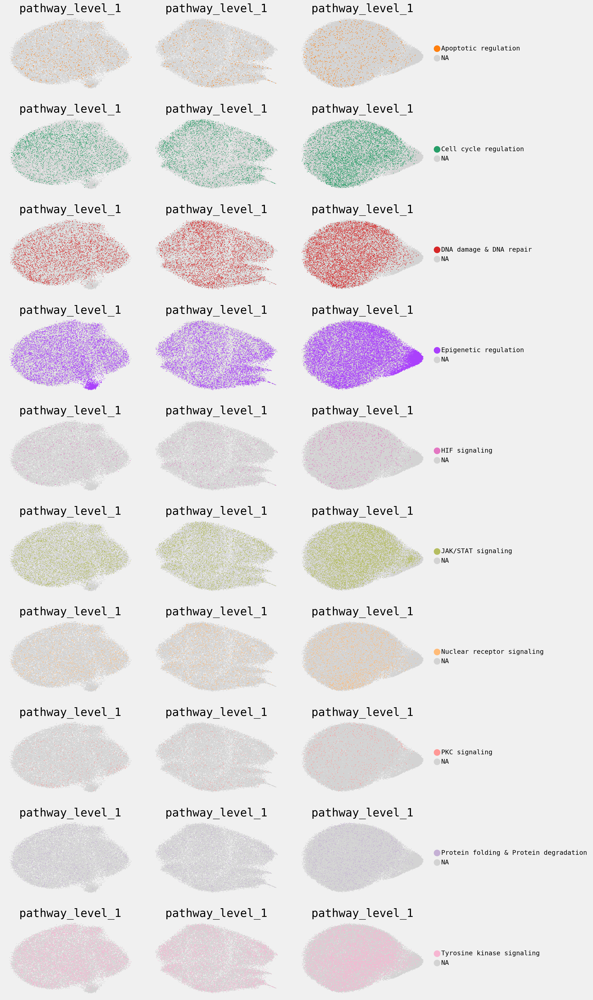

In [25]:
dose = 1e4
cond_A549 = adata_A549_lincs_genes.obs.dose==dose
cond_K562 = adata_K562_lincs_genes.obs.dose==dose
cond_MCF7 = adata_MCF7_lincs_genes.obs.dose==dose

cols = 3
rows = len(pathways)
size = 7
fig, ax = plt.subplots(rows, cols, figsize=(6*cols, 3*rows))

for i, pw in enumerate(pathways):
    sc.pl.umap(adata_A549_lincs_genes[cond_A549].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_K562_lincs_genes[cond_K562].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_MCF7_lincs_genes[cond_MCF7].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               size=size
              )
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

### All genes

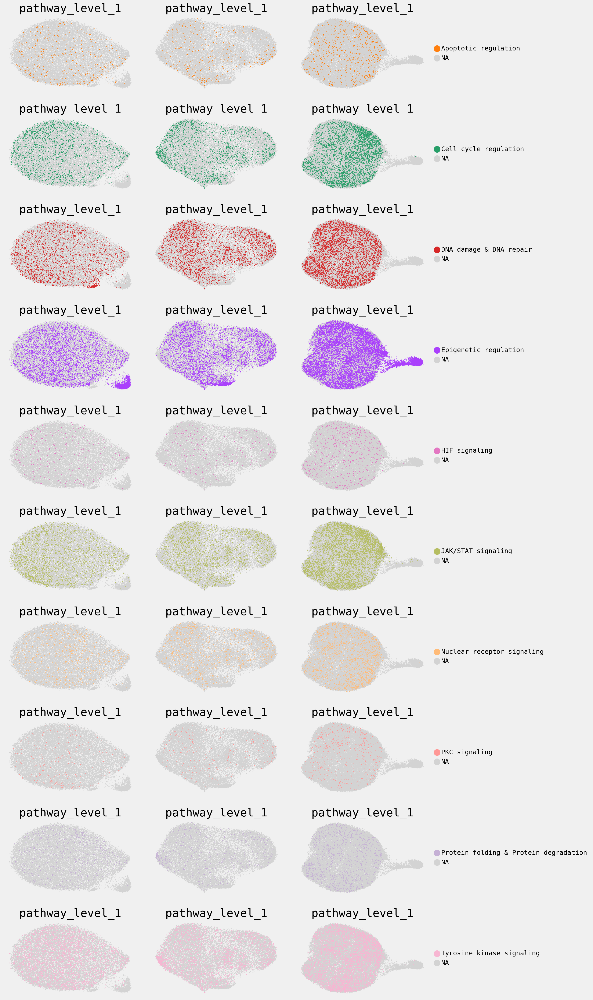

In [26]:
dose = 1e4
cond_A549 = adata_A549.obs.dose==dose
cond_K562 = adata_K562.obs.dose==dose
cond_MCF7 = adata_MCF7.obs.dose==dose

cols = 3
rows = len(pathways)
size = 7
fig, ax = plt.subplots(rows, cols, figsize=(6*cols, 3*rows))

for i, pw in enumerate(pathways):
    sc.pl.umap(adata_A549[cond_A549].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_K562[cond_K562].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_MCF7[cond_MCF7].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               size=size
              )
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

## Distribution of drugs with maximal dosage

### Identifying significant drugs for perturbations

The relevant information is take from Fig.S6 from the [supplement material](https://www.science.org/doi/suppl/10.1126/science.aax6234/suppl_file/aax6234-srivatsan-sm.pdf) of the orignial [paper](https://www.science.org/doi/full/10.1126/science.aax6234)

In [27]:
epigenetic_drugs = [
    'Dacinostat', 
    'Quisinostat', 
    'CUDC-907', 
    'Abexinostat',
    'Panobinostat',
    'Belinostat',
    'Givinostat',
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
    'AR-42', 
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Trichostatin', 
    'CUDC-101',
    'M344',
    'Resminostat',
]

dna_damage_drugs = [
    'Raltitrexed', #no_ood
    'Pirarubicin', 
]

cell_cycle_drugs = [
    'Epothilone',
    'Patupilone', #no_ood
    'Flavopiridol',
    'Hesperadin',
    'GSK1070916', #no_ood
]

apoptosis_drugs = [
    'JNJ-26854165' #no_ood
]

tyrosine_drugs = [
    'Trametinib', #no_ood
    'TAK-901',  #no_ood
    'Dasatinib' #no_ood
]

protein_drugs = [
    'Alvespimycin',
    'Tanespimycin',
    'Luminespib'
]


# Create list of potential ood_drugs
ood_drugs = ['control']
ood_drugs.extend(epigenetic_drugs)
ood_drugs.extend(dna_damage_drugs)
ood_drugs.extend(cell_cycle_drugs)
ood_drugs.extend(apoptosis_drugs)
ood_drugs.extend(tyrosine_drugs)
ood_drugs.extend(protein_drugs)

Create pathway dependent colour palette for more informative plotting 

In [28]:
grey_palette = dict(zip(adata_A549.obs.condition.cat.categories.values, 188*['red']))

colours = (
    ['grey']
    + len(epigenetic_drugs)*['008fd5'] 
    + len(dna_damage_drugs)*['fc4f30'] 
    + len(cell_cycle_drugs)*['e5ae38'] 
    + len(apoptosis_drugs)*['6d904f']
    + len(tyrosine_drugs)*['8b8b8b']
    + len(protein_drugs)*['810f7c']
)

palette = dict(zip(ood_drugs, colours))
for drug, colour in palette.items():
    if drug =='control': 
        continue
    if isinstance(colour, str):
        grey_palette[drug] = '#' + colour

### LINCS Genes

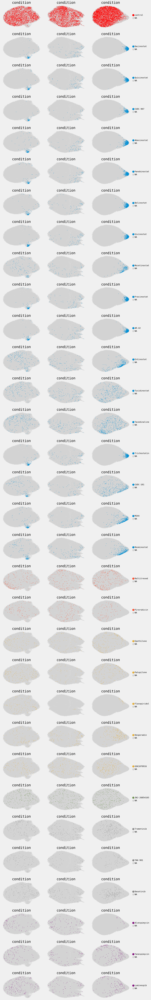

In [29]:
dose = 1e4
cond_A549 = (adata_A549_lincs_genes.obs.dose==dose) | (adata_A549_lincs_genes.obs.condition == 'control')
cond_K562 = (adata_K562_lincs_genes.obs.dose==dose) | (adata_K562_lincs_genes.obs.condition == 'control')
cond_MCF7 = (adata_MCF7_lincs_genes.obs.dose==dose) | (adata_MCF7_lincs_genes.obs.condition == 'control')

cols = 3
rows = len(ood_drugs)
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, drug in enumerate(ood_drugs):
    sc.pl.umap(adata_A549_lincs_genes[cond_A549].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_K562_lincs_genes[cond_K562].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_MCF7_lincs_genes[cond_MCF7].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()


### All genes

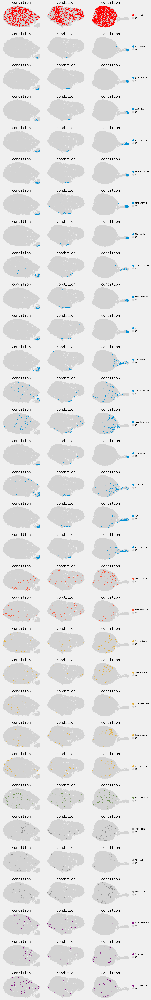

In [30]:
dose = 1e4
cond_A549 = (adata_A549.obs.dose==dose) | (adata_A549.obs.condition == 'control')
cond_K562 = (adata_K562.obs.dose==dose) | (adata_K562.obs.condition == 'control')
cond_MCF7 = (adata_MCF7.obs.dose==dose) | (adata_MCF7.obs.condition == 'control')

cols = 3
rows = len(ood_drugs)
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, drug in enumerate(ood_drugs):
    sc.pl.umap(adata_A549[cond_A549].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_K562[cond_K562].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_MCF7[cond_MCF7].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

## Create data split

### Divide into `'train'`, `'test'`, and `'ood'`

In [31]:
validation_drugs = [    
    'Alvespimycin',  
    'Luminespib',
    'Epothilone',
    'Flavopiridol',
    'Quisinostat', 
    'Abexinostat',
    'Panobinostat',
    'AR-42', 
    'Trichostatin', 
    'M344',
    'Resminostat',
    'Belinostat', #ood
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Patupilone', #no_ood
    'GSK1070916', #no_ood
    'JNJ-26854165' #no_ood
    'TAK-901',  #no_ood
    'Dasatinib' #no_ood
]
    
    
ood_drugs = [
    'Dacinostat', #ood
    'CUDC-907', #ood     
    'Givinostat', #ood
    'CUDC-101', #ood
    'Pirarubicin', #ood 
    'Hesperadin', #ood
    'Tanespimycin', #ood
    'Trametinib', #ood
    'Raltitrexed', #no_ood
]
    
additional_validation_drugs = [
    'YM155', #apoptosis
    'Barasertib', #cell cycle
    'Fulvestrant', #nuclear receptor
    'Nintedanib', #tyrosine
    'Rigosertib', #tyrosine 
    'BMS-754807', #tyrosine
    'KW-2449', #tyrosine
    'Crizotinib', #tyrosin
    'ENMD-2076', #cell cycle 
    'Alisertib', #cell cycle
    'JQ1', #epigenetic
]

validation_drugs.extend(additional_validation_drugs)

### Plot additonal validation drugs on all genes data

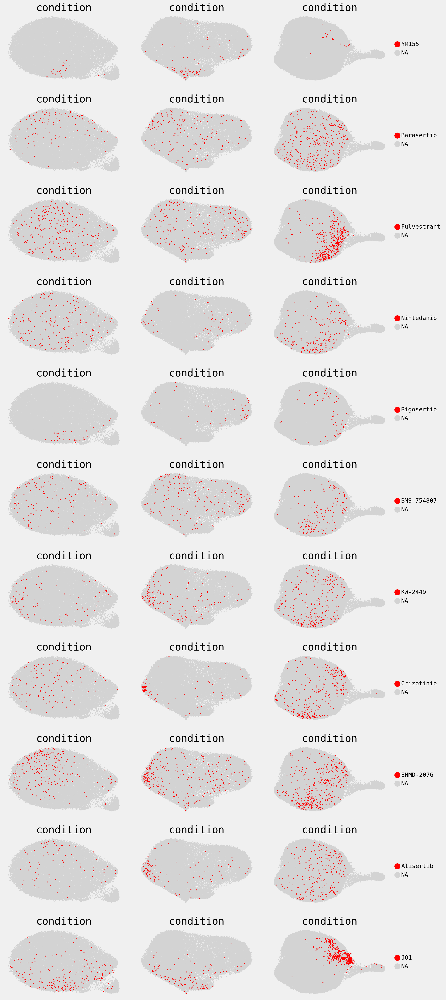

In [32]:
dose = 1e4
cond_A549 = (adata_A549.obs.dose==dose) | (adata_A549.obs.condition == 'control')
cond_K562 = (adata_K562.obs.dose==dose) | (adata_K562.obs.condition == 'control')
cond_MCF7 = (adata_MCF7.obs.dose==dose) | (adata_MCF7.obs.condition == 'control')

cols = 3
rows = len(additional_validation_drugs)
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, drug in enumerate(additional_validation_drugs):
    sc.pl.umap(adata_A549[cond_A549].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_K562[cond_K562].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_MCF7[cond_MCF7].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

In [33]:
# train
adata_sciplex.obs['split_ood_finetuning'] = 'train'

# ood
adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(ood_drugs), 'split_ood_finetuning'] = 'ood'

# test
validation_cond = (adata_sciplex.obs.condition.isin(validation_drugs)) & (adata_sciplex.obs.dose.isin([1e3, 1e4]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True, random_state=42).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.condition.isin(validation_drugs)) & (adata_sciplex.obs.dose.isin([1e1, 1e2]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.2, copy=True, random_state=42).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train')
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.04, copy=True, random_state=42).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train') & (adata_sciplex.obs.control.isin([1]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.05, copy=True, random_state=42).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

In [34]:
adata_sciplex.obs.condition.value_counts()

control            13004
ENMD-2076           5757
PD98059             3763
Tranylcypromine     3744
WP1066              3722
                   ...  
AT9283              1795
Patupilone          1481
Flavopiridol        1407
Epothilone          1221
YM155                770
Name: condition, Length: 188, dtype: int64

In [35]:
adata_sciplex.obs['split_ood_finetuning'].value_counts()

train    513476
test      45519
ood       22782
Name: split_ood_finetuning, dtype: int64

In [36]:
pd.crosstab(adata_sciplex.obs['split_ood_finetuning'], 
            adata_sciplex.obs['condition'][adata_sciplex.obs['condition'].isin(ood_drugs)])

condition,CUDC-101,CUDC-907,Dacinostat,Givinostat,Hesperadin,Pirarubicin,Raltitrexed,Tanespimycin,Trametinib
split_ood_finetuning,,,,,,,,,
ood,3209,2417,2516,3105,1949,2388,2514,2210,2474


In [37]:
pd.crosstab(adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='ood','dose'], 
            adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='ood','condition'])

condition,CUDC-101,CUDC-907,Dacinostat,Givinostat,Hesperadin,Pirarubicin,Raltitrexed,Tanespimycin,Trametinib
dose,,,,,,,,,
10.0,1027,798,780,896,567,674,617,813,443
100.0,831,660,572,878,432,676,640,599,693
1000.0,763,592,556,708,512,700,577,422,789
10000.0,588,367,608,623,438,338,680,376,549


In [38]:
pd.crosstab(adata_sciplex.obs['split_ood_finetuning'], 
            adata_sciplex.obs['condition'][adata_sciplex.obs['condition'].isin(validation_drugs)])

condition,JQ1,AR-42,Abexinostat,Alisertib,Alvespimycin,BMS-754807,Barasertib,Belinostat,Crizotinib,Dasatinib,ENMD-2076,Entinostat,Epothilone,Flavopiridol,Fulvestrant,GSK1070916,KW-2449,Luminespib,M344,Mocetinostat,Nintedanib,Panobinostat,Patupilone,Pracinostat,Quisinostat,Resminostat,Rigosertib,Tacedinaline,Trichostatin,Tucidinostat,YM155
split_ood_finetuning,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
test,997,898,932,699,579,871,832,977,807,814,1760,1104,397,394,1044,810,934,611,972,694,965,874,505,921,797,1054,552,1196,955,710,220
train,2040,2003,1981,1402,1279,1805,1589,2048,1979,1724,3997,2281,824,1013,2376,1692,2098,1394,2182,1284,2030,1699,976,2021,1557,2265,1387,2468,2128,1543,550


In [39]:
pd.crosstab(adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='test', 'dose'], 
            adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='test','condition'])

condition,JQ1,2-Methoxyestradiol,A-366,ABT-737,AC480,AG-14361,AG-490,AICAR,AMG-900,AR-42,AT9283,AZ,AZD1480,Abexinostat,Alendronate,Alisertib,Altretamine,Alvespimycin,Aminoglutethimide,Amisulpride,Anacardic,Andarine,Aurora,Avagacestat,Azacitidine,BMS-265246,BMS-536924,BMS-754807,BMS-911543,BRD4770,Barasertib,Baricitinib,Belinostat,Bisindolylmaleimide,Bosutinib,Busulfan,CEP-33779,CYC116,Capecitabine,Carmofur,Cediranib,Celecoxib,Cerdulatinib,Cimetidine,Clevudine,Costunolide,Crizotinib,Curcumin,Cyclocytidine,Danusertib,...,Rigosertib,Roscovitine,Roxadustat,Rucaparib,Ruxolitinib,S-Ruxolitinib,S3I-201,SB431542,SGI-1776,SL-327,SNS-314,SRT1720,SRT2104,SRT3025,Selisistat,Sirtinol,Sodium,Sorafenib,Streptozotocin,TAK-901,TG101209,TGX-221,TMP195,Tacedinaline,Tazemetostat,Temsirolimus,Thalidomide,Thiotepa,Tie2,Tofacitinib,Toremifene,Tozasertib,Tranylcypromine,Triamcinolone,Trichostatin,Tubastatin,Tucidinostat,UNC0379,UNC0631,UNC1999,Valproic,Vandetanib,Veliparib,WHI-P154,WP1066,XAV-939,YM155,ZM,Zileuton,control
dose,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1152
10.0,175,27,37,29,21,36,40,47,26,202,29,25,25,199,30,147,31,196,32,42,30,50,36,29,31,30,26,193,13,42,156,28,198,40,41,29,34,27,34,28,44,23,33,32,41,36,187,49,31,23,...,179,38,9,27,34,36,43,24,51,37,21,28,40,28,32,44,33,33,33,24,37,33,36,257,23,18,36,40,42,43,45,24,48,40,199,43,148,37,54,34,41,38,26,52,54,18,62,30,37,0
100.0,163,34,35,26,33,35,39,43,28,185,21,36,45,183,15,115,36,133,26,31,35,40,18,38,36,39,36,180,18,41,138,36,181,22,34,52,37,39,40,31,32,22,37,41,38,26,158,44,39,21,...,171,32,30,21,28,39,33,24,39,38,20,21,33,33,32,44,34,39,32,21,34,45,18,230,30,17,31,39,39,30,30,12,35,27,192,29,82,30,28,40,36,28,28,36,39,32,51,36,37,0
1000.0,317,23,36,14,41,30,32,26,21,257,13,25,23,264,22,238,49,163,44,23,32,33,26,34,41,22,30,291,32,34,274,32,339,34,25,35,30,36,32,39,32,21,44,30,28,43,269,44,30,21,...,151,28,20,22,15,41,32,31,35,26,23,41,28,35,32,24,31,32,34,14,31,30,31,358,38,19,38,30,21,38,40,17,29,28,324,40,218,36,33,39,37,46,25,38,32,32,63,19,33,0
10000.0,342,18,40,18,27,31,37,35,27,254,19,16,17,286,26,199,35,87,44,44,43,35,25,42,28,33,28,207,29,35,264,36,259,4,16,34,38,19,44,25,21,46,25,22,41,31,193,48,20,17,...,51,30,25,23,42,35,41,45,15,24,18,32,35,35,46,35,27,13,40,8,23,37,36,351,27,22,31,30,43,33,17,20,30,38,240,36,262,10,35,34,38,20,30,34,39,18,44,19,43,0


## Add epigenetic holdout split

In [40]:
# train
adata_sciplex.obs['split_ood_finetuning'] = 'train'

# ood
adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(ood_drugs), 'split_ood_finetuning'] = 'ood'


validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train')
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.04, copy=True, random_state=42).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train') & (adata_sciplex.obs.control.isin([1]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.05, copy=True, random_state=42).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

In [41]:
from sklearn.model_selection import train_test_split

epigenetic_drugs_all = adata_sciplex.obs.condition[adata_sciplex.obs.pathway_level_1 == "Epigenetic regulation"].unique()

epigenetic_drugs = [
    'Dacinostat', 
    'Quisinostat', 
    'CUDC-907', 
    'Abexinostat',
    'Panobinostat',
    'Belinostat',
    'Givinostat',
    'AR-42', 
    'Trichostatin', 
    'CUDC-101',
    'M344',
    'Resminostat',
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
]

ood_epi_drugs = [
    'Dacinostat', 
    'Quisinostat', 
    'CUDC-907', 
    'Abexinostat',
    'Panobinostat',
    'Belinostat',
    'Givinostat',
    'AR-42',
]

val_epi_drugs = [
    'Trichostatin', 
    'CUDC-101',
    'M344',
    'Resminostat',
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
]    
    

In [42]:
adata_sciplex.obs.condition.isin(epigenetic_drugs_all).sum()

147875

In [43]:
if 'split_ho_epigenetic' not in list(adata_sciplex.obs):
    print("Addig 'split_ho_epigenetic' to 'adata_sciplex.obs'.")
    obs_train, obs_val = train_test_split(adata_sciplex.obs.index, test_size=0.05, random_state=42)
#     obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_sciplex.obs['split_ho_epigenetic'] = 'train'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_val), 'split_ho_epigenetic'] = 'test'
    
    # test
    validation_cond = (adata_sciplex.obs.condition.isin(val_epi_drugs)) & (adata_sciplex.obs.dose.isin([1e3, 1e4]))
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True, random_state=42).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    

    validation_cond = (adata_sciplex.obs.condition.isin(val_epi_drugs)) & (adata_sciplex.obs.dose.isin([1e1, 1e2]))
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True, random_state=42).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    
    validation_cond = adata_sciplex.obs.condition.isin(epigenetic_drugs_all[~epigenetic_drugs_all.isin(epigenetic_drugs)])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True, random_state=42).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    
    validation_cond = adata_sciplex.obs.control.isin([True])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True, random_state=42).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    
    adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(ood_epi_drugs), 'split_ho_epigenetic'] = 'ood'

Addig 'split_ho_epigenetic' to 'adata_sciplex.obs'.


In [44]:
if 'split_ho_epigenetic_all' not in list(adata_sciplex.obs):
    print("Addig 'split_ho_epigenetic_all' to 'adata_sciplex.obs'.")
    obs_train, obs_val = train_test_split(adata_sciplex.obs.index, test_size=0.05, random_state=42)
#     obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_sciplex.obs['split_ho_epigenetic_all'] = 'train'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_val), 'split_ho_epigenetic_all'] = 'test'
    
    validation_cond = adata_sciplex.obs.condition.isin(epigenetic_drugs_all[~epigenetic_drugs_all.isin(epigenetic_drugs)])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.5, copy=True, random_state=42).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic_all'] = 'test'
    
    validation_cond = adata_sciplex.obs.control.isin([True])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True, random_state=42).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic_all'] = 'test'
    
    adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(epigenetic_drugs), 'split_ho_epigenetic_all'] = 'ood'
    

Addig 'split_ho_epigenetic_all' to 'adata_sciplex.obs'.


In [45]:
pd.crosstab(
    adata_sciplex.obs.split_ho_epigenetic,
    adata_sciplex.obs.control
)

control,0,1
split_ho_epigenetic,,
ood,21804,0
test,75253,5639
train,471716,7365


In [46]:
pd.crosstab(
    adata_sciplex.obs.split_ho_epigenetic_all,
    adata_sciplex.obs.control
)

control,0,1
split_ho_epigenetic_all,,
ood,48791,0
test,73073,5639
train,446909,7365


## Add random split

In [48]:
if 'split_random' not in list(adata_sciplex.obs):
    print("Addig 'split_random' to 'adata_sciplex.obs'.")
    obs_train, obs_tmp = train_test_split(adata_sciplex.obs.index, test_size=0.3, random_state=42)
    obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5, random_state=42)

    adata_sciplex.obs['split_random'] = 'train'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_val), 'split_random'] = 'test'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_test), 'split_random'] = 'ood'

Addig 'split_random' to 'adata_sciplex.obs'.


In [49]:
pd.crosstab(
    adata_sciplex.obs.split_random,
    adata_sciplex.obs.control
)

control,0,1
split_random,,
ood,85331,1936
test,85304,1963
train,398138,9105


## Save `adata_sciplex` and `adata_sciplex_lincs_genes`

In [50]:
assert (adata_sciplex.obs.index == adata_sciplex_lincs_genes.obs.index).all()

adata_sciplex_lincs_genes.obs['split_ood_finetuning'] = adata_sciplex.obs['split_ood_finetuning']
adata_sciplex_lincs_genes.obs['split_ho_epigenetic'] = adata_sciplex.obs['split_ho_epigenetic']
adata_sciplex_lincs_genes.obs['split_ho_epigenetic_all'] = adata_sciplex.obs['split_ho_epigenetic_all']
adata_sciplex_lincs_genes.obs['split_random'] = adata_sciplex.obs['split_random']

In [52]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_v2.h5ad', adata_sciplex)

In [53]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_lincs_genes_v2.h5ad', adata_sciplex_lincs_genes)

______

In [54]:
adata_sciplex = sc.read(PROJECT_DIR/'datasets'/'sciplex_complete_v2.h5ad')
adata_sciplex

AnnData object with n_obs × n_vars = 581777 × 2000
    obs: 'cell_type', 'dose', 'dose_character', 'dose_pattern', 'g1s_score', 'g2m_score', 'pathway', 'pathway_level_1', 'pathway_level_2', 'product_dose', 'product_name', 'proliferation_index', 'replicate', 'size_factor', 'target', 'vehicle', 'batch', 'n_counts', 'dose_val', 'condition', 'drug_dose_name', 'cov_drug_dose_name', 'cov_drug', 'control', 'split_ho_pathway', 'split_tyrosine_ood', 'split_epigenetic_ood', 'split_cellcycle_ood', 'SMILES', 'split_ood_finetuning', 'split_ho_epigenetic', 'split_ho_epigenetic_all', 'split_random'
    var: 'id', 'num_cells_expressed-0-0', 'num_cells_expressed-1-0', 'num_cells_expressed-1', 'gene_id', 'in_lincs', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'all_DEGs', 'hvg', 'lincs_DEGs', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [55]:
adata_sciplex_lincs_genes = sc.read(PROJECT_DIR/'datasets'/'sciplex_complete_lincs_genes_v2.h5ad')
adata_sciplex_lincs_genes

AnnData object with n_obs × n_vars = 581777 × 977
    obs: 'cell_type', 'dose', 'dose_character', 'dose_pattern', 'g1s_score', 'g2m_score', 'pathway', 'pathway_level_1', 'pathway_level_2', 'product_dose', 'product_name', 'proliferation_index', 'replicate', 'size_factor', 'target', 'vehicle', 'batch', 'n_counts', 'dose_val', 'condition', 'drug_dose_name', 'cov_drug_dose_name', 'cov_drug', 'control', 'split_ho_pathway', 'split_tyrosine_ood', 'split_epigenetic_ood', 'split_cellcycle_ood', 'SMILES', 'split_ood_finetuning', 'split_ho_epigenetic', 'split_ho_epigenetic_all', 'split_random'
    var: 'id', 'num_cells_expressed-0-0', 'num_cells_expressed-1-0', 'num_cells_expressed-1', 'gene_id', 'in_lincs', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'all_DEGs', 'hvg', 'lincs_DEGs', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

_________

### Check splits

In [56]:
pd.crosstab(
    adata_sciplex.obs.split_ood_finetuning,
    adata_sciplex.obs.control
)

control,0,1
split_ood_finetuning,,
ood,22782,0
test,21859,1125
train,524132,11879


In [57]:
pd.crosstab(
    adata_sciplex.obs.split_ho_pathway,
    adata_sciplex.obs.control
)

control,0,1
split_ho_pathway,,
ood,12423,0
test,83439,1964
train,472911,11040


____

## Create small sciplex dataset

In [58]:
adatas = []

for perturbation in np.unique(adata_sciplex.obs.condition): 
    tmp = adata_sciplex[adata_sciplex.obs.condition == perturbation].copy()
    tmp = sc.pp.subsample(tmp, n_obs=40, copy=True, random_state=42)
    adatas.append(tmp)

adata_subset = adatas[0].concatenate(adatas[1:])
adata_subset.uns = adata_sciplex.uns.copy()

adata_subset

/nfs/staff-hdd/hetzell/miniconda3/envs/chemical_CPA/lib/python3.7/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


AnnData object with n_obs × n_vars = 7520 × 2000
    obs: 'cell_type', 'dose', 'dose_character', 'dose_pattern', 'g1s_score', 'g2m_score', 'pathway', 'pathway_level_1', 'pathway_level_2', 'product_dose', 'product_name', 'proliferation_index', 'replicate', 'size_factor', 'target', 'vehicle', 'batch', 'n_counts', 'dose_val', 'condition', 'drug_dose_name', 'cov_drug_dose_name', 'cov_drug', 'control', 'split_ho_pathway', 'split_tyrosine_ood', 'split_epigenetic_ood', 'split_cellcycle_ood', 'SMILES', 'split_ood_finetuning', 'split_ho_epigenetic', 'split_ho_epigenetic_all', 'split_random'
    var: 'id', 'gene_id', 'in_lincs', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'num_cells_expressed-0-0', 'num_cells_expressed-1-0', 'num_cells_expressed-1'
    uns: 'all_DEGs', 'hvg', 'lincs_DEGs', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'

In [59]:
if 'split' not in list(adata_subset.obs):
    print("Addig 'split' to 'adata_subset.obs'.")
    obs_train, obs_tmp = train_test_split(adata_subset.obs.index, test_size=0.3)
    obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_subset.obs['split'] = 'train'
    adata_subset.obs.loc[adata_subset.obs.index.isin(obs_val), 'split'] = 'test'
    adata_subset.obs.loc[adata_subset.obs.index.isin(obs_test), 'split'] = 'ood'

Addig 'split' to 'adata_subset.obs'.


In [60]:
adata_subset.obs.split.value_counts()

train    5264
test     1128
ood      1128
Name: split, dtype: int64

In [61]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_subset_lincs_genes_v2.h5ad', adata_subset)

____

## Create middle sized sci-Plex subset

In [62]:
delete_idx =[]
for drug, df in adata_sciplex.obs.groupby('condition'): 
    # Low dose
    cond = df.dose.isin([10])
    idx = df[cond].sample(frac=0.6).index
    delete_idx.extend(idx)
    # Small dose
    cond = df.dose.isin([100])
    idx = df[cond].sample(frac=0.5).index
    delete_idx.extend(idx)
    # Middle dose 
    cond = df.dose.isin([1000])
    idx = df[cond].sample(frac=0.3).index
    delete_idx.extend(idx)
    # High dose 
    cond = df.dose.isin([10000])
    idx = df[cond].sample(frac=0.15).index
    delete_idx.extend(idx)

In [63]:
cond = ~pd.Series(adata_sciplex.obs.index).isin(delete_idx)

In [64]:
cond.sum()

354640

In [65]:
cond = cond.to_list()

In [66]:
assert (adata_sciplex.obs.index == adata_sciplex_lincs_genes.obs.index).all()

In [67]:
adata = adata_sciplex[cond].copy()
adata_lincs_genes = adata_sciplex_lincs_genes[cond].copy()

In [68]:
pd.crosstab(
    adata.obs.split_ood_finetuning,
    adata.obs.control
)

control,0,1
split_ood_finetuning,,
ood,13451,0
test,13141,1125
train,315044,11879


In [69]:
pd.crosstab(
    adata.obs.split_ho_pathway,
    adata.obs.control
)

control,0,1
split_ho_pathway,,
ood,10559,0
test,49610,1964
train,281467,11040


In [70]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_middle_subset_v2.h5ad', adata)

In [71]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_middle_subset_lincs_genes_v2.h5ad', adata_lincs_genes)